In [ ]:
# Proyecto Final- Modelos Computacionales
# Claudia Coutiño Vásquez

In [3]:
# Cargar paqueterías
import numpy as np

import matplotlib as mpl
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib import cm


import seaborn as sns
import networkx as nx
import networkx.algorithms.community as nx_comm

import pandas as pd
import scipy.io
from scipy.io import loadmat
from IPython.display import HTML

In [5]:
# Matriz de Coactivación del Conectoma Humano
mat_data = loadmat(r"C:\Users\clau\Desktop\Repositorio\Coactivation_matrix.mat")
print(mat_data.keys()) # Explorar claves

dict_keys(['__header__', '__version__', '__globals__', 'Coactivation_matrix', 'Coord'])


In [7]:
# 1) Definir grafos con la matriz estableciendo umbrales de coactivación de 0.8, 0.9 y 1 y graficar cada grafo
# Añadir las coordenadas tridimensionales (incluidas en el archivo.mat)

# Extraer matriz y coordenadas 3D
matrix = mat_data['Coactivation_matrix'] 
coordinates = mat_data['Coord']

print(f"Dimensiones de la Matriz: {matrix.shape}") # Hay 638 Regiones Cerebrales (nodos)
print(f"Dimensiones de las Coordenadas: {coordinates.shape}") # Respectivas Coordenadas 3D

Dimensiones de la Matriz: (638, 638)
Dimensiones de las Coordenadas: (638, 3)


In [9]:
# Definir grafo
def create_graph(matrix, threshold, coordinates):
    MatAdj = (matrix >= threshold).astype(int) # Matriz de Adyacencia Binaria
    np.fill_diagonal(MatAdj, 0)
    G = nx.from_numpy_array(MatAdj)
    
    # Coordenadas 3D
    for i, coord in enumerate(coordinates):
        G.nodes[i]['pos'] = coord

    return G

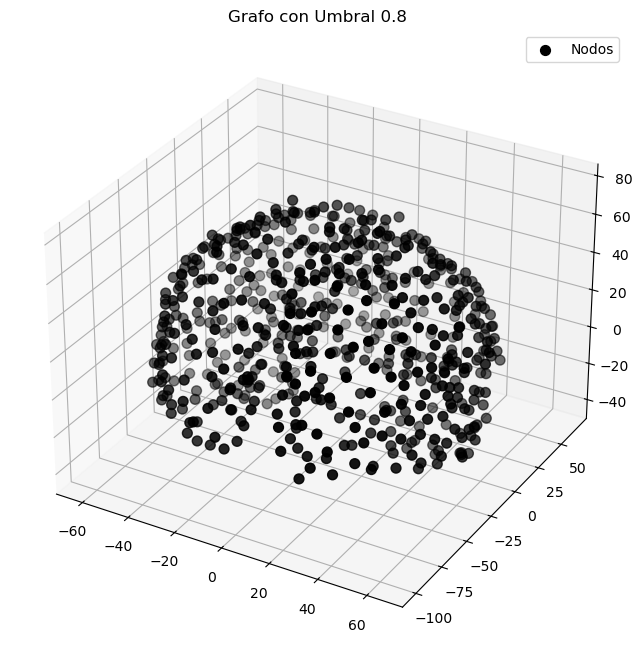

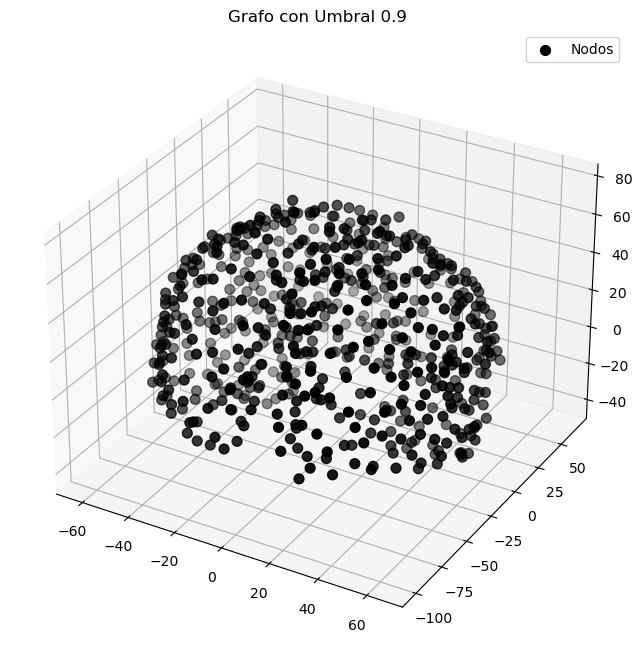

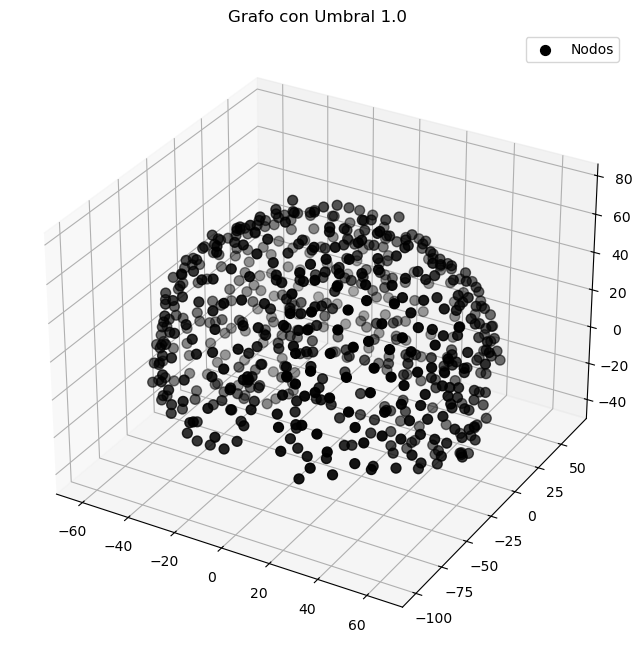

In [9]:
# Modificar Umbrales
thresholds = [0.8, 0.9, 1.0]
graphs = {threshold: create_graph(matrix, threshold, coordinates) for threshold in thresholds}

# 3D
def plot_graph(G, title):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    pos = nx.get_node_attributes(G, 'pos') # Posiciones
    x, y, z = np.array(list(pos.values())).T

    ax.scatter(x, y, z, c='black', s=50, label='Nodos') # Nodos

    for edge in G.edges(): # Aristas
        x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
        ax.plot(x_edge, y_edge, z_edge, c='gray', alpha=0.5)

    ax.set_title(title)
    plt.legend()
    plt.show()

# Graficar
for threshold, graph in graphs.items():
    plot_graph(graph, f"Grafo con Umbral {threshold}")

In [11]:
# 2) Con uno de los grafos en el punto uno con umbral 0.9, generar una animación donde se haga girar 360° el grafo del cerebro para 
# visualizar las conexiones establecidas.

# Animación
def animate_3d(G, title):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    pos = nx.get_node_attributes(G, 'pos') # Posiciones Nodos
    x, y, z= np.array(list(pos.values())).T
    
    for node, (x, y, z) in pos.items(): # Nodos
        ax.scatter(x, y, z, s=50, c='black', alpha=0.7)

    for edge in G.edges():  # Aristas
        x_edge, y_edge, z_edge = zip(pos[edge[0]],pos[edge[1]])
        lines.append(ax.plot( x_edge, y_edge, z_edge, c= 'gray', alpha= 0.5)[0])
        ax.set_title("Grafo con Umbral: 0.9")
    
    # Rotación
    def update(frame):
        ax.view_init(elev=20, azim=frame)
        return fig,

    # Animar
    ani = FuncAnimation(fig, update, frames=range(0, 360, 2), interval=50, blit=False)
    plt.close(fig)
    return HTML(ani.to_jshtml())

# Generar animación- Grafo con umbral 0.9
threshold = 0.9
G = create_graph(matrix, threshold, coordinates)
animate_3d(G, "Grafo con Umbral 0.9")

Animation size has reached 21066346 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Grados de los nodos: {0: 5, 1: 5, 2: 4, 3: 3, 4: 3, 5: 3, 6: 4, 7: 8, 8: 3, 9: 3, 10: 2, 11: 3, 12: 3, 13: 1, 14: 1, 15: 4, 16: 5, 17: 3, 18: 4, 19: 8, 20: 3, 21: 3, 22: 4, 23: 3, 24: 4, 25: 3, 26: 2, 27: 4, 28: 4, 29: 4, 30: 3, 31: 5, 32: 4, 33: 3, 34: 4, 35: 5, 36: 4, 37: 6, 38: 16, 39: 3, 40: 5, 41: 6, 42: 5, 43: 3, 44: 6, 45: 4, 46: 3, 47: 2, 48: 4, 49: 4, 50: 4, 51: 3, 52: 2, 53: 3, 54: 5, 55: 4, 56: 2, 57: 5, 58: 2, 59: 4, 60: 2, 61: 3, 62: 5, 63: 5, 64: 6, 65: 6, 66: 4, 67: 5, 68: 5, 69: 7, 70: 10, 71: 4, 72: 4, 73: 5, 74: 4, 75: 3, 76: 4, 77: 4, 78: 3, 79: 2, 80: 4, 81: 6, 82: 3, 83: 4, 84: 5, 85: 3, 86: 5, 87: 5, 88: 3, 89: 3, 90: 2, 91: 3, 92: 3, 93: 5, 94: 2, 95: 3, 96: 3, 97: 4, 98: 5, 99: 4, 100: 9, 101: 3, 102: 3, 103: 3, 104: 5, 105: 3, 106: 4, 107: 3, 108: 4, 109: 3, 110: 5, 111: 3, 112: 4, 113: 5, 114: 2, 115: 3, 116: 4, 117: 3, 118: 4, 119: 3, 120: 5, 121: 8, 122: 5, 123: 3, 124: 4, 125: 5, 126: 7, 127: 3, 128: 5, 129: 2, 130: 6, 131: 6, 132: 4, 133: 3, 134: 5, 135: 9

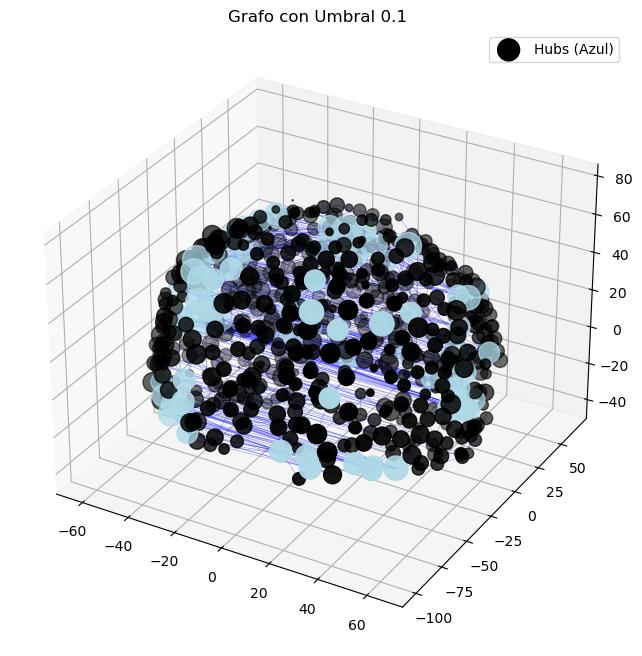

In [71]:
# 3) Encontrar los hubs del grafo, y establecer el tamaño del nodo proporcional al valor del grado

def plot_hubs(G, title="Hubs"):
    degrees = dict(G.degree()) # Calcular grados
    max_degree = max(degrees.values()) # Máx
    min_degree = min(degrees.values()) # Min
    print("Grados de los nodos:", degrees)
    print("Grado Máx:", max_degree)
    print("Grado Min:", min_degree)

    # Tamaño que corresponda al Grado
    min_size, max_size = 0.5, 500
    grad_max = max(degrees.values())
    node_sizes = [
        min_size + (degree / grad_max) * (max_size - min_size) for degree in degrees.values()
    ]

    pos = nx.get_node_attributes(G, 'pos')  # Posiciones 3D
    x, y, z = np.array(list(pos.values())).T  # Extraer Coordenadas 3D

    # Identificar Hubs
    threshold = np.percentile(list(degrees.values()), 90)
    hubs = [node for node, degree in degrees.items() if degree >= threshold]
    print(f"Hubs (grado mayor que {threshold}): {hubs}")

    # Cambiar color a Hubs (azul), los demás nodos en negro
    nod_col = ['lightblue' if node in hubs else 'black' for node in G.nodes()]

    # Graficar
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    scatter = ax.scatter(x, y, z, c=nod_col, s=node_sizes, label='Nodos') # Nodos
    for edge in G.edges(): # Aristas
        x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
        ax.plot(x_edge, y_edge, z_edge, c='blue', alpha=0.5, linewidth=0.3)

    ax.set_title(title) # Ajustar título y leyenda
    ax.legend(["Hubs (Azul)"])
    plt.show()

# Grafo con Umbral de 0.1
G_01 = create_graph(matrix, 0.1, coordinates)
plot_hubs(G_01, "Grafo con Umbral 0.1") # Umbral para filtrar conexiones y generar Matriz Binaria

# Grado máx. 18-> el nodo más conectado tiene 18 enlaces
# Grado mín. 0-> hay nodos sin conexiones
# Los Nodos más grandes son los hubs (+conexiones), los más pequeños (tienen menor grado).
# Hubs: 77 (nodos con grado mayor a 8)

C:\Users\clau\anaconda3\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\clau\anaconda3\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


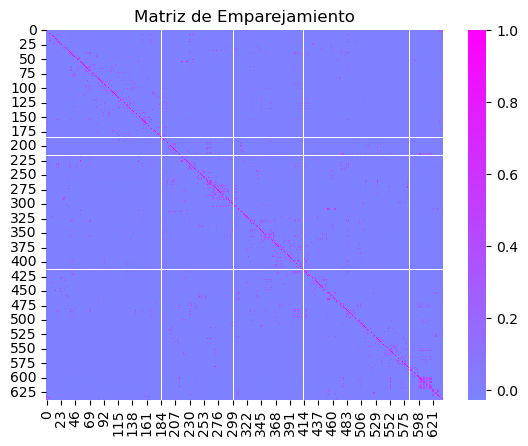

Partición: {0: 0, 1: 0, 2: 4, 3: 4, 4: 0, 5: 4, 6: 4, 7: 2, 8: 3, 9: 4, 10: 4, 11: 4, 12: 4, 13: 4, 14: 4, 15: 4, 16: 2, 17: 4, 18: 4, 19: 2, 20: 4, 21: 4, 22: 5, 23: 5, 24: 5, 25: 5, 26: 5, 27: 6, 28: 5, 29: 6, 30: 5, 31: 6, 32: 6, 33: 5, 34: 6, 35: 6, 36: 6, 37: 7, 38: 2, 39: 7, 40: 7, 41: 7, 42: 2, 43: 7, 44: 2, 45: 8, 46: 7, 47: 9, 48: 9, 49: 9, 50: 10, 51: 9, 52: 11, 53: 9, 54: 12, 55: 8, 56: 8, 57: 8, 58: 8, 59: 8, 60: 10, 61: 8, 62: 2, 63: 7, 64: 7, 65: 7, 66: 9, 67: 9, 68: 7, 69: 2, 70: 2, 71: 9, 72: 8, 73: 8, 74: 8, 75: 8, 76: 8, 77: 8, 78: 8, 79: 8, 80: 8, 81: 0, 82: 0, 83: 0, 84: 0, 85: 0, 86: 0, 87: 9, 88: 9, 89: 2, 90: 9, 91: 9, 92: 9, 93: 2, 94: 2, 95: 9, 96: 9, 97: 2, 98: 9, 99: 9, 100: 2, 101: 9, 102: 9, 103: 9, 104: 9, 105: 9, 106: 9, 107: 9, 108: 9, 109: 9, 110: 9, 111: 9, 112: 9, 113: 9, 114: 8, 115: 8, 116: 8, 117: 8, 118: 2, 119: 8, 120: 8, 121: 8, 122: 8, 123: 8, 124: 8, 125: 2, 126: 2, 127: 8, 128: 8, 129: 2, 130: 2, 131: 8, 132: 8, 133: 8, 134: 9, 135: 2, 136: 9

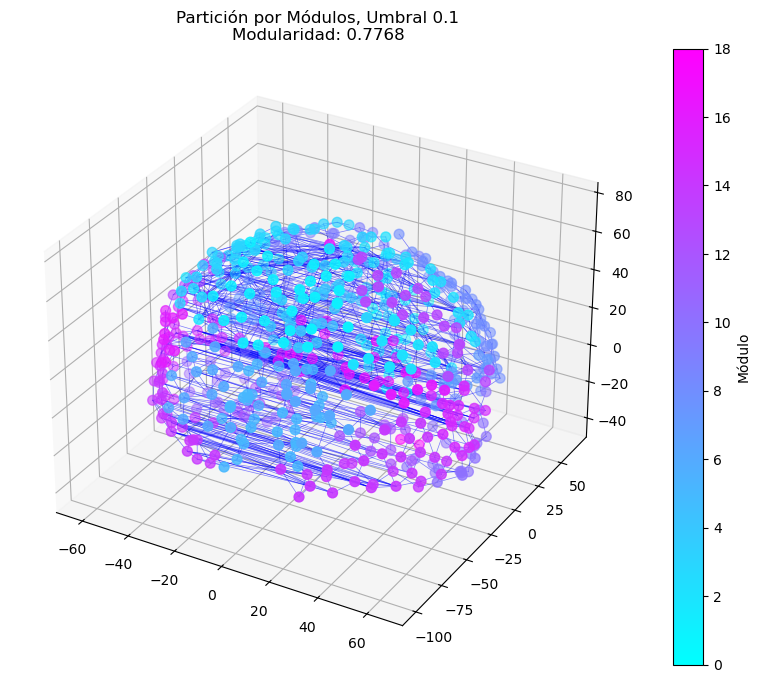

No. Módulos: 19


In [45]:
# 4) En función de la matriz de emparejamiento (correlación de la matriz de adyacencia), establecer una partición de los nodos en módulos.
# Escoger el número de módulos que creas conveniente y justificar por qué escogiste ese número

# Importar paquete para análisis de redes
from community import community_louvain

def modulos(G, Emparejamiento):
    MatAdj = nx.to_numpy_array(G) # Sacamos la matriz de adyacencia
    Cor_Mat = np.corrcoef(MatAdj) # Matriz de emparejamiento 

    sns.heatmap(Cor_Mat, cmap="cool", center=0) # Visualizar la matriz de emparejamiento
    plt.title("Matriz de Emparejamiento")
    plt.show()

    G_clean = G.copy() # Excluir nodos con grado 0
    nodes_0 = [node for node, degree in G.degree() if degree == 0]
    G_clean.remove_nodes_from(nodes_0)

    particion = community_louvain.best_partition(G_clean) # Partición por Módulos utilizando Algoritmo de Louvain
    print("Partición:", particion)

    modularidad = community_louvain.modularity(particion, G_clean) # Modularidad
    print(f"Modularidad: {modularidad:.4f}")

    
    nodcol = list(particion.values()) # Colorear nodos según su módulo

    # Obtener posiciones
    pos = nx.get_node_attributes(G_clean, 'pos')
    if not pos:
        raise ValueError("No hay posiciones 3D asignadas a los nodos.")

    x, y, z = np.array(list(pos.values())).T

    # Figura en 3D
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    scatter = ax.scatter(x, y, z, c=nodcol, cmap="cool", s=50, label='Nodos') # Graficar Nodos
    for edge in G_clean.edges(): # Graficar Aristas
        x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
        ax.plot(x_edge, y_edge, z_edge, c='b', alpha=0.5, linewidth=0.5)

    # Título & leyenda
    ax.set_title(f"{Emparejamiento}\nModularidad: {modularidad:.4f}")
    plt.colorbar(scatter, ax=ax, label="Módulo")
    plt.show()

    return particion

G_01 = create_graph(matrix, 0.1, coordinates)  # Grafo con Umbral de 0.1
particion = modulos(G_01, "Partición por Módulos, Umbral 0.1")
num_modules = len(set(particion.values())) # Conteo Explícito de los Módulos
print(f"No. Módulos: {num_modules}")

In [47]:
# Justificación
# Los módulos son grupos de nodos (en este caso, regiones cerebrales) más interconectados entre sí, se realizó una partición para identificar mejor 
# grupos estructurales y/o funcionales, así como la interacción con otros módulos. La división del grafo en módulos se evalúa con la modularidad y para 
# calcularla se utilizó el método Louvain. El valor resultante fue 0.77, un valor alto que indica buena partición (módulos definidos porque las regiones 
# del cerebro representadas en el conectoma están bien organizadas -por su función y conexiones-). El sistema nervioso presenta alta modularidad pues 
# áreas agrupadas en un módulo pueden compartir funciones (sensoriales, motoras, cognitivas) y eso garantiza eficiencia en términos de energía para la 
# comunicación (interacciones dentro del módulo). Para contar el no. de módulos se eliminaron los nodos con grado 0 para no sesgar el análisis; se 
# obtuvieron 19 que serían los grupos de regiones (nodos altamente interconectados entre sí) que trabajan sincrónicamente dentro de la red, como son 
# varios se puede hacer un análisis más específico (ej. redes especializadas para ver diferencias en patologías), si fueran pocos módulos ayudaría para 
# tener una visión más global.

Nodos del Rich Club: [38, 70, 186, 230, 235, 253, 262, 328, 330, 334, 346, 356, 362, 397, 400, 407, 416, 454, 473, 477, 481, 482, 485, 488, 491, 494, 532, 599, 603, 606, 607, 616, 617, 619, 629]


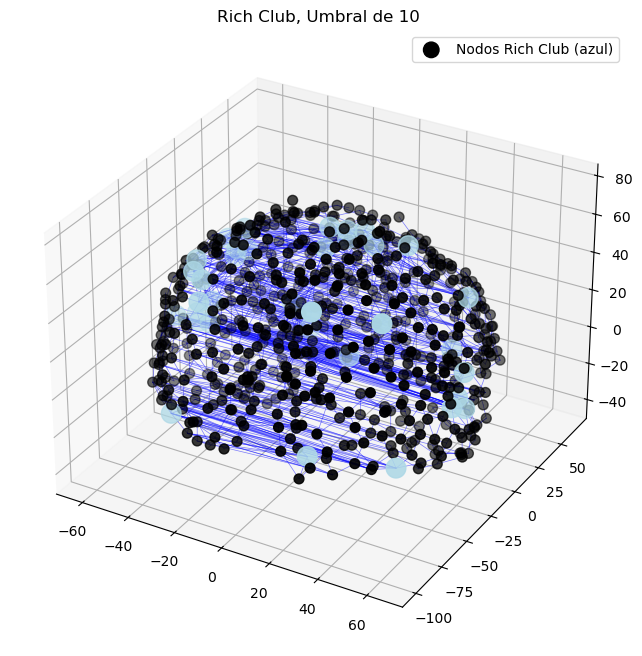

In [49]:
# 5) Determinar el conjunto del Rich Club y discutir las implicaciones anatómicas y funcionales de este grupo de nodos (mínimo 100 palabras).

def rich_club(G, RichClub, min_degree=10):
    degrees = dict(G.degree()) # Calcular grados
    rc_nodes= [node for node, degree in degrees.items() if degree >= min_degree] # Seleccionar nodos respecto al umbral
    print(f"Nodos del Rich Club: {rc_nodes}")

    pos= nx.get_node_attributes(G, 'pos') # Posiciones nodos
    x,y,z = np.array(list(pos.values())).T

    n_color = ['lightblue' if node in rc_nodes else 'black' for node in G.nodes()]
    n_sizes = [200 if node in rc_nodes else 50 for node in G.nodes()]

    # Generar Grafo
    fig= plt.figure(figsize=(12,8))
    ax= fig.add_subplot(111, projection='3d')

    ax.scatter(x, y, z, c=n_color, s=n_sizes, label='Nodos') # Nodos 
    for edge in G.edges(): # Aristas
        if edge[0] in pos and edge[1] in pos:
            x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
            ax.plot(x_edge, y_edge, z_edge, c='b', alpha=0.5, linewidth=0.5)

    ax.set_title(RichClub)
    plt.legend(["Nodos Rich Club (azul)"])
    plt.show()

# Grafo con umbral 0.1
G_01= create_graph(matrix, 0.1, coordinates)
rich_club(G_01, "Rich Club, Umbral de 10", min_degree=10)

In [ ]:
# Discusión
# El Rich Club hace referencia a un conjunto de nodos altamente conectados (localmente y entre sí) dentro de una red. Para obtenerlos, se identifican 
# nodos con mayor grado de conexión superando lo que se esperaría por azar. Se obtuvieron 36 y se encuentran distribuidos en la parte central y de cortezas.
# Anatómicamente, corresponden a regiones importantes para la integración de la información: el tálamo (relevo sensorial más importante, es subcortical 
# hacia el centro), cortezas de asociación multimodal (como la parietal que recibe y manda info sensorio-motora -ej. con M1-, Prefrontal con el componente 
# cognitivo, Visual -V1, V2-). Funcionalmente, la densidad de conexiones asegura la robustez del sistema frente a lesiones como TBI o EVC.

{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}
Nodos del Rich Club (grado ≥ 10): [38, 70, 186, 230, 235, 253, 262, 328, 330, 334, 346, 356, 362, 397, 400, 407, 416, 454, 473, 477, 481, 482, 485, 488, 491, 494, 532, 599, 603, 606, 607, 616, 617, 619, 629]
{'grado_medio': 3.691542288557214, 'coeficiente_de_agrupamiento': 0.22183658427439523, 'centralidad_cercania': 0.09214115900724197, 'centralidad_intermediacion': 0.016110568269096143}

Comparación de propiedades:
Grado_medio:
  Original: 4.5298
  Modificado: 3.6915
  Cambio: -18.51%

Coeficiente_de_agrupamiento:
  Original: 0.2436
  Modificado: 0.2218
  Cambio: -8.95%

Centralidad_cercania:
  Original: 0.1194
  Modificado: 0.0921
  Cambio: -22.83%

Centralidad_intermediacion:
  Original: 0.0115
  Modificado: 0.0161
  Cambio: 40.37%



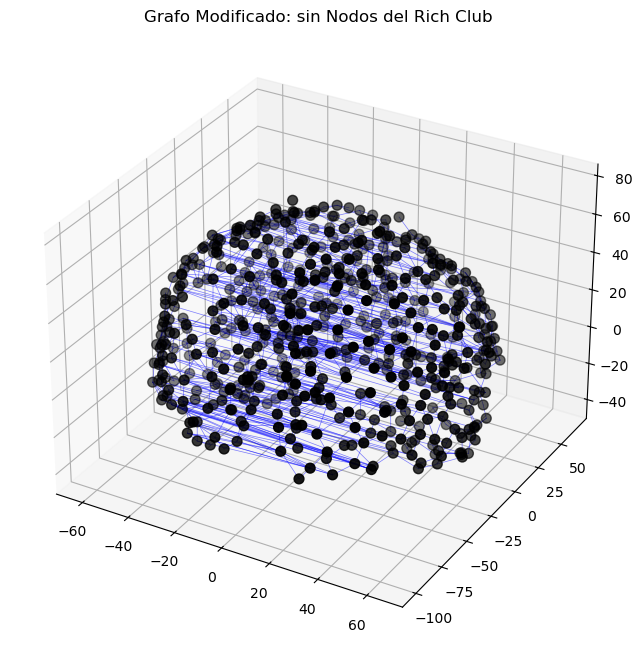

In [51]:
# 6) Supongamos que eliminamos los nodos del RichClub, describir cómo cambian las propiedades topológicas del grafo, hacer comparativas 
# del grado, coeficiente de cluster, coeficiente de mundo pequeño y las medidas de centralidad (cercanía, intermediación)

def propiedades_grafo(G):
    propiedades = {}

    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes() # Grado Promedio
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G) # Coeficiente Cluster
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values())) # Cercanía
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G) # Intermediación
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades


# Comparaciones con el Grafo Modificado
def comparacion_propiedades(datos_originales, datos_modificados):
    print("\nComparación de propiedades:")
    for prop in datos_originales.keys():
        original = datos_originales[prop]
        modificado = datos_modificados[prop]
        cambio = ((modificado - original) / original) * 100 if original != 0 else "N/A"
        print(f"{prop.capitalize()}:")
        print(f"  Original: {original:.4f}")
        print(f"  Modificado: {modificado:.4f}")
        print(f"  Cambio: {cambio if cambio == 'N/A' else cambio:.2f}%\n")

# Grafo Original
grafo_original = create_graph(matrix, 0.1, coordinates)
grados = dict(grafo_original.degree())
datos_originales = propiedades_grafo(grafo_original) # Propiedades Iniciales
print(datos_originales)

# Seleccionar Nodos del Rich Club
min_degree = 10
rc_nodes = [node for node, degree in grados.items() if degree >= min_degree]
print(f"Nodos del Rich Club (grado ≥ {min_degree}): {rc_nodes}")


# Eliminación Nodos del Rich Club
grafo_modificado = grafo_original.copy() # Copiar Grafo
grafo_modificado.remove_nodes_from(rc_nodes) # Eliminar nodos
datos_modificados = propiedades_grafo(grafo_modificado) # Propiedades
print(datos_modificados)



comparacion_propiedades(datos_originales, datos_modificados) # Comparar Propiedades

# Visualizar Grafo Modificado
def plot_grafo(G, titulo):
    pos = nx.get_node_attributes(G, 'pos')
    x, y, z = np.array(list(pos.values())).T

    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Nodos & Aristas
    scatter = ax.scatter(x, y, z, c='black', s=50)
    for edge in G.edges():
        x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
        ax.plot(x_edge, y_edge, z_edge, c='blue', alpha=0.5, linewidth=0.5)

    ax.set_title(titulo)
    plt.show()

plot_grafo(grafo_modificado, "Grafo Modificado: sin Nodos del Rich Club")

In [53]:
# Análsis
# El grado promedio (conexiones x nodo) disminuyó porque los nodos del Rich Club suelen tener grados altos (muchas conexiones). El coeficiente de cluster 
# (propensión de formar triángulos, conexión entre los vecinos) disminuyó poco; el coeficiente de mundo pequeño también se reduce (y la longitud promedio 
# de caminos aumenta -la cercanía entre nodos se reduce-). La intermediación aumenta, tal vez porque los nodos que no eran los principales conectores 
# ahora lo son para compensar la pérdida de los Rich Clubs (el valor se refiere a la frecuencia con la que un nodo actúa como intermediario en los caminos 
# más cortos). Implicaciones de estos cambios: habrá un procesamiento e integración de la información deficiente porque la red es menos densa, volviéndola 
# también más vulnerable a daños (menor redundancia, además del cambio en la distribución al quitar los Rich Clubs), comunicación menos eficiente (porque 
# se requiere más tiempo para transferir info de un lugar a otro).

In [75]:
# 7) Quitar 10%-50% de los nodos con mayor medida de intermediación y describir cómo cambian las propiedades topológicas del grafo, 
# hacer comparativas del grado, coeficiente de cluster, coeficiente de mundo pequeño y las medidas de centralidad (cercanía, intermediación)

def propiedades_grafo(G):
    propiedades = {}

    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes() # Grado Promedio
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G) # Coeficiente de Cluster
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values())) # Cercanía
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G) # Intermediación
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades


# Comparación entre Grafos
def comparacion_propiedades(datos_originales, datos_modificados):
    print("\nComparación de propiedades:")
    for prop in datos_originales.keys():
        original = datos_originales[prop]
        modificado = datos_modificados[prop]
        cambio = ((modificado - original) / original) * 100 if original != 0 else "N/A"
        print(f"{prop.capitalize()}:")
        print(f"  Original: {original:.4f}")
        print(f"  Modificado: {modificado:.4f}")
        print(f"  Cambio: {cambio if cambio == 'N/A' else cambio:.2f}%\n")


# Eliminar % nodos determinado
def eliminar_porcentaje(G, percentaje=0.1):
    betweenness = nx.betweenness_centrality(G) # Intermediación
    sorted_nodes = sorted(betweenness.items(), key=lambda x: x[1], reverse=True) # Ordenar de > a <

    n_nodos_e = int(len(sorted_nodes) * percentaje) # No. nodos a eliminar
    nodos_elim = [node for node, _ in sorted_nodes[:n_nodos_e]]

    # Crear una copia del grafo y eliminar los nodos
    grafo_modificado = G.copy()
    grafo_modificado.remove_nodes_from(nodos_elim)

    print(f"Eliminando el {percentaje*100}% de nodos con mayor intermediación: {nodos_elim}")
    
    return grafo_modificado


# Grafo Original
grafo_original = create_graph(matrix, 0.1, coordinates)
datos_originales = propiedades_grafo(grafo_original) # Propiedades
print(datos_originales)


# Eliminar % de Nodos con Mayor Centralidad
percentajes = [0.1, 0.2, 0.3, 0.4, 0.5]
grafo_modificado1 = eliminar_porcentaje(grafo_original, percentaje=percentajes[0])
grafo_modificado2 = eliminar_porcentaje(grafo_original, percentaje=percentajes[1])
grafo_modificado3 = eliminar_porcentaje(grafo_original, percentaje=percentajes[2])
grafo_modificado4 = eliminar_porcentaje(grafo_original, percentaje=percentajes[3])
grafo_modificado5 = eliminar_porcentaje(grafo_original, percentaje=percentajes[4])


# Calcular nuevas propiedades de cada grafo
datos_modificados_10 = propiedades_grafo(grafo_modificado1) # Datos 10%
print(datos_modificados_10)

datos_modificados_20 = propiedades_grafo(grafo_modificado2) # Datos 20%
print(datos_modificados_20)

datos_modificados_30 = propiedades_grafo(grafo_modificado3) # Datos 30%
print(datos_modificados_30)

datos_modificados_40 = propiedades_grafo(grafo_modificado4) # Datos 40%
print(datos_modificados_40)

datos_modificados_50 = propiedades_grafo(grafo_modificado5) # Datos 50%
print(datos_modificados_50)

# Comparar Propiedades
comparacion_propiedades(datos_originales, datos_modificados_10)
comparacion_propiedades(datos_originales, datos_modificados_20)
comparacion_propiedades(datos_originales, datos_modificados_30)
comparacion_propiedades(datos_originales, datos_modificados_40)
comparacion_propiedades(datos_originales, datos_modificados_50)


# Visualizar Nuevos Grafos
def plot_grafo(G, titulo):
    pos = nx.get_node_attributes(G, 'pos')
    x, y, z = np.array(list(pos.values())).T

    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Nodos & Aristas
    scatter = ax.scatter(x, y, z, c='black', s=50)
    for edge in G.edges():
        x_edge, y_edge, z_edge = zip(pos[edge[0]], pos[edge[1]])
        ax.plot(x_edge, y_edge, z_edge, c='purple', alpha=0.5, linewidth=0.5)

    ax.set_title(titulo)
    plt.show()

{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}
Eliminando el 10.0% de nodos con mayor intermediación: [334, 277, 276, 235, 400, 272, 353, 121, 38, 482, 230, 154, 284, 160, 41, 196, 532, 286, 629, 473, 159, 202, 598, 485, 330, 356, 195, 367, 271, 480, 494, 50, 454, 281, 488, 312, 220, 619, 344, 128, 427, 618, 565, 16, 153, 315, 405, 2, 186, 285, 303, 599, 3, 237, 0, 318, 346, 481, 431, 597, 434, 432, 302]
Eliminando el 20.0% de nodos con mayor intermediación: [334, 277, 276, 235, 400, 272, 353, 121, 38, 482, 230, 154, 284, 160, 41, 196, 532, 286, 629, 473, 159, 202, 598, 485, 330, 356, 195, 367, 271, 480, 494, 50, 454, 281, 488, 312, 220, 619, 344, 128, 427, 618, 565, 16, 153, 315, 405, 2, 186, 285, 303, 599, 3, 237, 0, 318, 346, 481, 431, 597, 434, 432, 302, 496, 584, 97, 491, 69, 275, 580, 591, 65, 223, 428, 292, 345, 549, 262, 605, 232, 93, 55, 226, 5

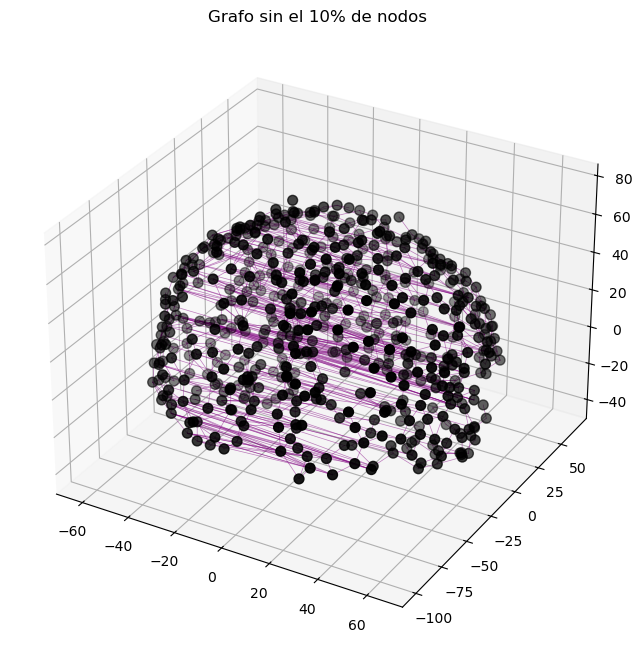

In [76]:
# Graficar
plot_grafo(grafo_modificado1, "Grafo sin el 10% de nodos")
# Grado Promedio (Original: 4.5298, Modificado: 3.6278)
# Coeficiente de Cluster: (Original: 0.2436, Modificado: 0.2303)
# Cercania: (Original: 0.1194, Modificado: 0.0800)
# Intermediacion: (Original: 0.0115, Modificado: 0.0184)

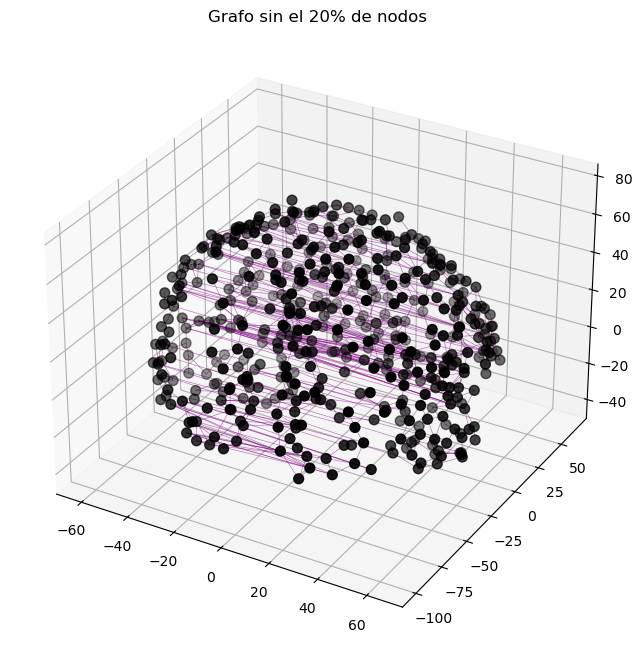

In [79]:
plot_grafo(grafo_modificado2, "Grafo sin el 20% de nodos")
# Grado Promedio: (Original: 4.5298, Modificado: 3.0959)
# Coeficiente de Cluster: (Original: 0.2436, Modificado: 0.2017)
# Cercania: (Original: 0.1194, Modificado: 0.0500)
# Intermediacion: (Original: 0.0115, Modificado: 0.0191)

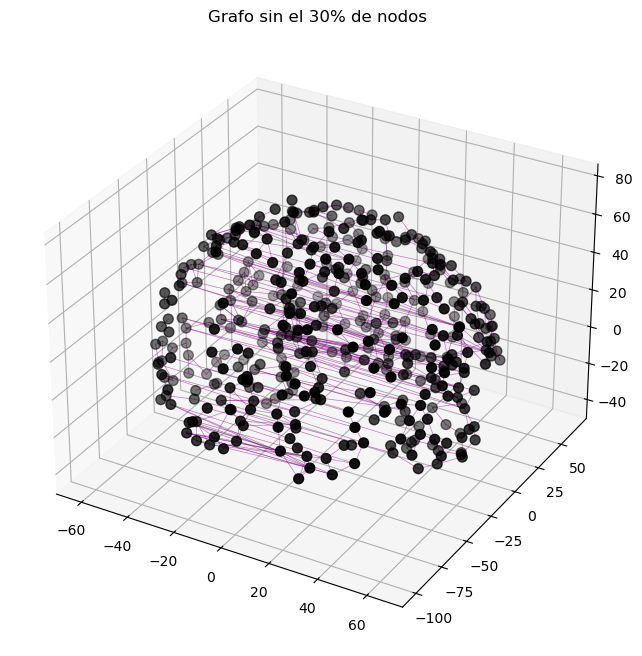

In [80]:
plot_grafo(grafo_modificado3, "Grafo sin el 30% de nodos")
# Grado Promedio: (Original: 4.5298, Modificado: 2.7025)
# Coeficiente de Cluster: (Original: 0.2436, Modificado: 0.1928)
# Cercania: (Original: 0.1194, Modificado: 0.0337)
# Intermediacion: (Original: 0.0115, Modificado: 0.0252)

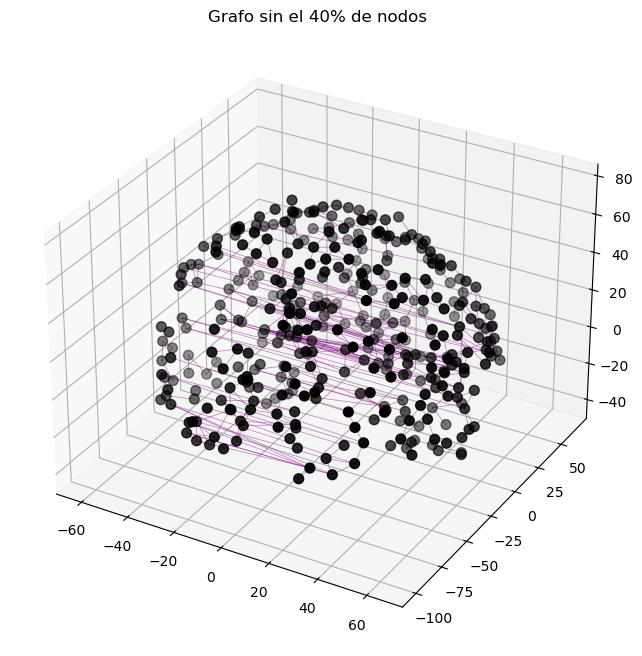

In [83]:
plot_grafo(grafo_modificado4, "Grafo sin el 40% de nodos")
# Grado Promedio: (Original: 4.5298, Modificado: 2.2715)
# Coeficiente de Cluster: (Original: 0.2436, Modificado: 0.1727)
# Cercania: (Original: 0.1194, Modificado: 0.0166)
# Intermediacion: (Original: 0.0115, Modificado: 0.0028)

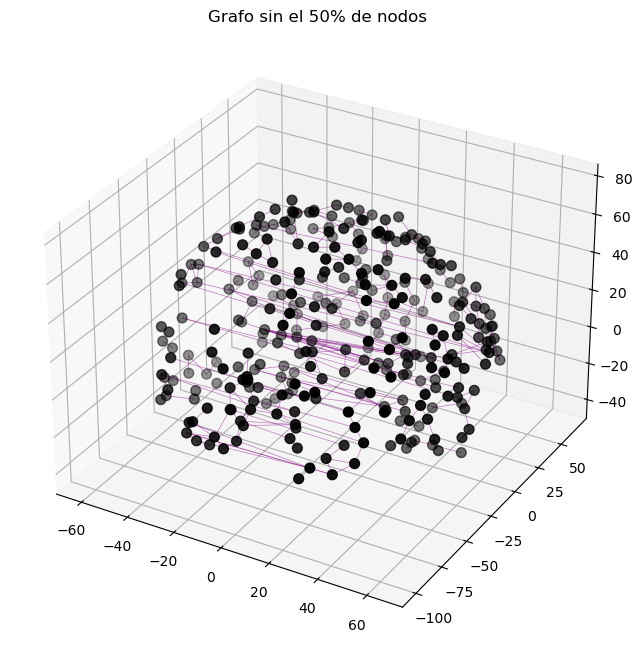

In [85]:
plot_grafo(grafo_modificado5, "Grafo sin el 50% de nodos") # Muy vacío :<
# Grado Promedio: (Original: 4.5298, Modificado: 1.7868)
# Coeficiente de Cluster: (Original: 0.2436, Modificado: 0.1340)
# Cercania: (Original: 0.1194, Modificado: 0.0108)
# Intermediacion: (Original: 0.0115, Modificado: 0.0007)

In [ ]:
# Análisis
# Los siguientes valores van disminuyendo progresivamente: Grado Promedio (4.5298-> 1.7868), Coeficiente de Cluster (0.2436-> 0.1340), Cercanía 
# (0.1194-> 0.0108). La Intermediación incrementa un poco (0.0252) hasta que se elimina el 30% de los nodos para recaer (0.0007) drásticamente al 
# eliminar el 50%. En la red se refleja por cómo se pierden conexiones entre nodos, la act. de los vecinos se reduce, los caminos se alargan... 
# En conjunto hace que la eficiencia disminuya con comunicación más lenta e incluso pérdida de sincronización. Inicialmente el sistema trata de compensar 
# la pérdida (por los valores de intermediación), pero conforme se quitan más nodos la red se vuelve tan fragmentada que es difícil mantener el 
# flujo de información.

{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.012750546214496058, 'centralidad_cercania': 0.21910876675945326, 'centralidad_intermediacion': 0.005072761300105849}

Comparación de propiedades:
Grado_medio:
  Original: 4.5298
  Modificado: 4.5298
  Cambio: 0.00%

Coeficiente_de_agrupamiento:
  Original: 0.2436
  Modificado: 0.0128
  Cambio: -94.77%

Centralidad_cercania:
  Original: 0.1194
  Modificado: 0.2191
  Cambio: 83.50%

Centralidad_intermediacion:
  Original: 0.0115
  Modificado: 0.0051
  Cambio: -55.80%



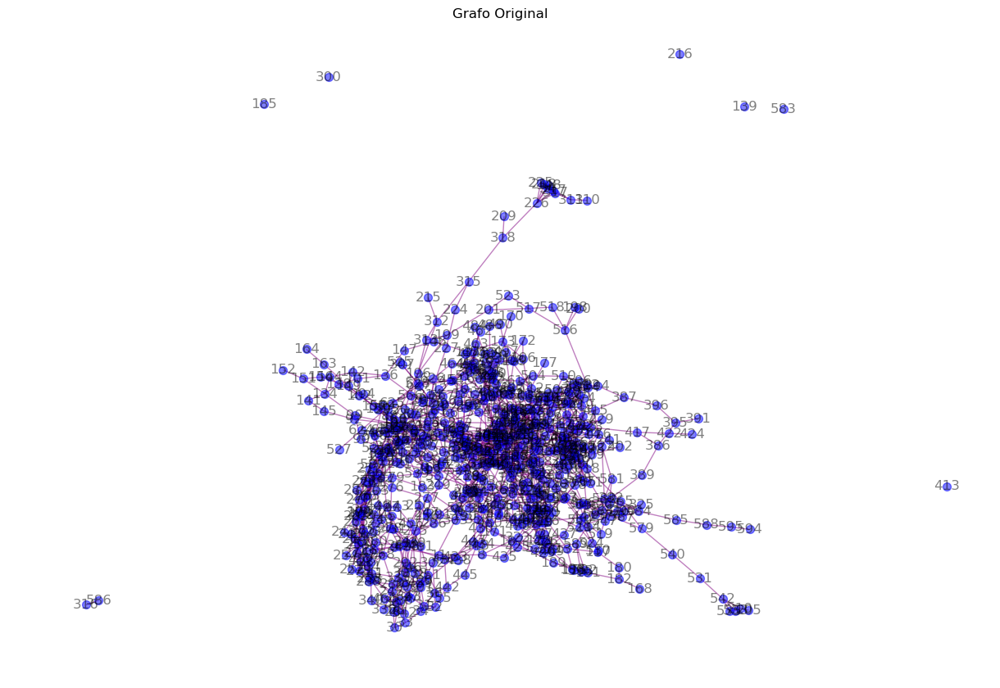

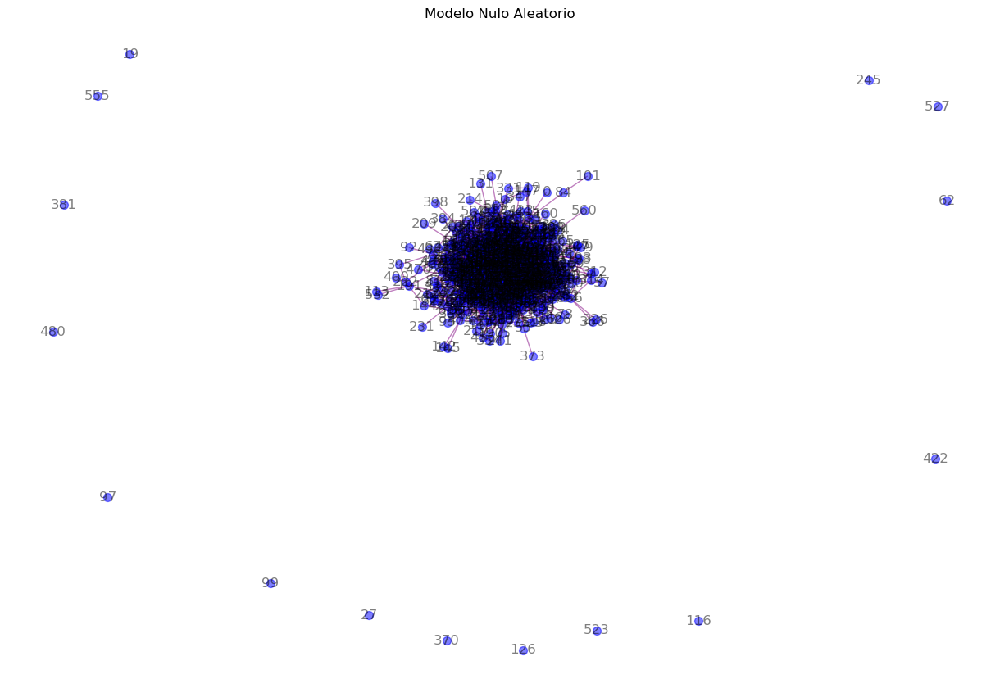

In [89]:
# 8) Generar un modelo nulo aleatorio donde se tenga el mismo número de nodos y el mismo número total de conexiones, y comparar sus 
# propiedades con el grafo original del cerebro.

def propiedades_grafo(G):
    propiedades = {}

    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes() # Grado Proedio
    propiedades['grado_medio'] = avg_grad
    coef_cluster = nx.average_clustering(G) # Coeficiente Cluster
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster
    cercania = np.mean(list(nx.closeness_centrality(G).values())) # Cercanía
    propiedades['centralidad_cercania'] = cercania
    betweenness = nx.betweenness_centrality(G) # Intermediación
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades


# Camparación
def comparacion_propiedades(datos_originales, datos_modificados):
    print("\nComparación de propiedades:")
    for prop in datos_originales.keys():
        original = datos_originales[prop]
        modificado = datos_modificados[prop]
        cambio = ((modificado - original) / original) * 100 if original != 0 else "N/A"
        print(f"{prop.capitalize()}:")
        print(f"  Original: {original:.4f}")
        print(f"  Modificado: {modificado:.4f}")
        print(f"  Cambio: {cambio if cambio == 'N/A' else cambio:.2f}%\n")


# Grafo original
grafo_original = create_graph(matrix, 0.1, coordinates)
datos_originales = propiedades_grafo(grafo_original) # Propiedades
print(datos_originales)

# Modelo Nulo Aleatorio
num_nodos = grafo_original.number_of_nodes()
num_aristas = grafo_original.number_of_edges()
modelo_nulo = nx.gnm_random_graph(num_nodos, num_aristas) # = no. Aristas
datos_nulo = propiedades_grafo(modelo_nulo) # Propiedades
print(datos_nulo)


# Comparación Propiedades
comparacion_propiedades(datos_originales, datos_nulo)

# Visualización
def plot_grafo(G, titulo):
    pos = nx.spring_layout(G)  # 2D
    plt.figure(figsize=(12, 8))
    nx.draw(G, pos, with_labels=True, node_color='blue', node_size=50, edge_color='purple', alpha=0.5)
    plt.title(titulo)
    plt.show()

plot_grafo(grafo_original, "Grafo Original")
plot_grafo(modelo_nulo, "Modelo Nulo Aleatorio")

In [ ]:
# Análisis
# Los componentes que mostraron una disminución fueron: Cluster (0.2436-> 0.0128, entonces se pierde la organización local), Intermediación 
# (0.0115-> 0.0051, pérdida de hubs). Por otro lado, la Cercanía incrementa (0.1194-> 0.2191, hace que la red sea más homogénea y haya más eficiencia 
# pero no tanta especialización, el SN tiene hubs como estrategia para resolver esto). El Grado Promedio se mantuvo igual (porque sólo se aleatorizaron 
# las conexiones).

{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}
{'grado_medio': 4.507836990595611, 'coeficiente_de_agrupamiento': 0.0065007305579866895, 'centralidad_cercania': 0.22925025719194556, 'centralidad_intermediacion': 0.005050484416596508}
Comparamos propiedades:
Grado_medio:
  Original: 4.5298
  Modificado: 4.5078
  Cambio: -0.48%

Coeficiente_de_agrupamiento:
  Original: 0.2436
  Modificado: 0.0065
  Cambio: -97.33%

Centralidad_cercania:
  Original: 0.1194
  Modificado: 0.2293
  Cambio: 92.00%

Centralidad_intermediacion:
  Original: 0.0115
  Modificado: 0.0051
  Cambio: -56.00%



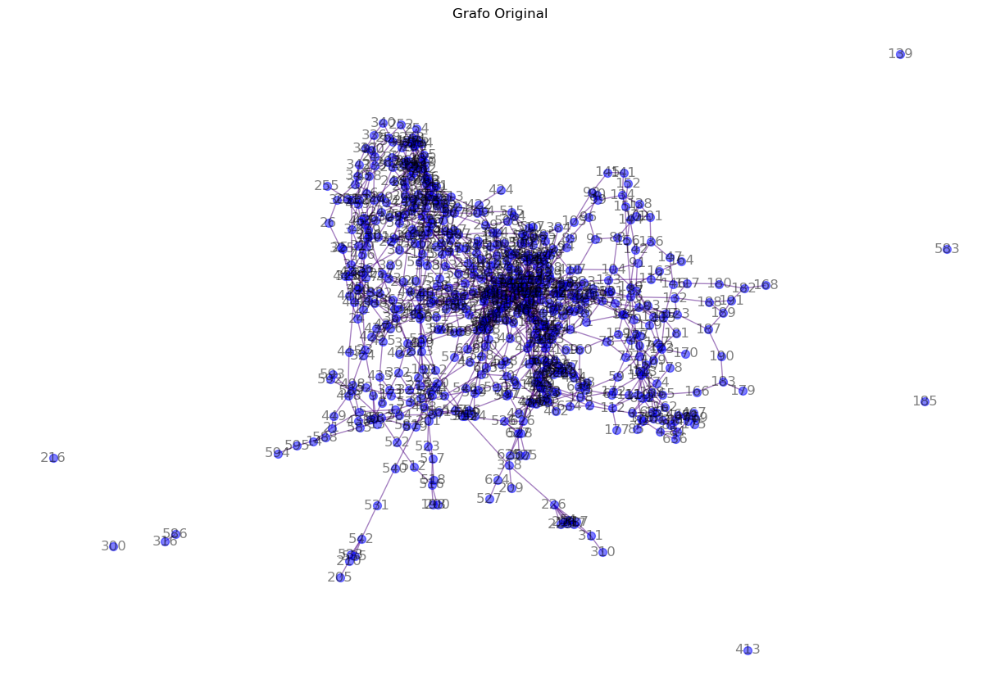

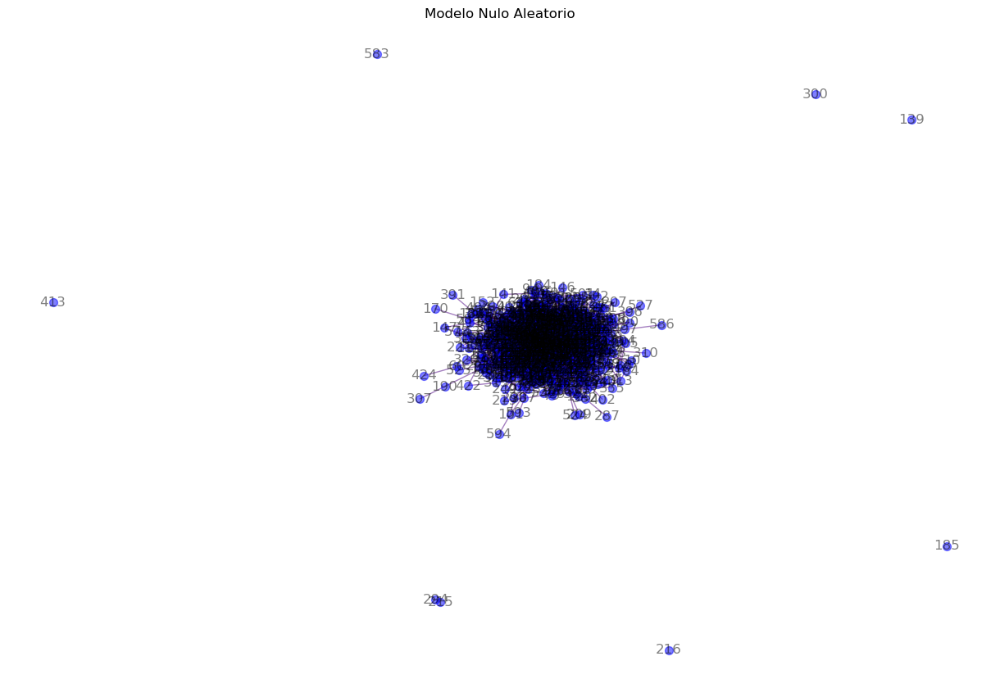

In [29]:
# 9) Generar un modelo nulo aleatorio donde se conserve la distribución de grado y comparar sus propiedades con el grafo original del cerebro

def propiedades_grafo(G):
    propiedades = {}

    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes() # Grado Promedio
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G) # Coeficiente Cluster
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values())) # Cercanía
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G) # Intermediación
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades

def comparacion_propiedades(datos_originales, datos_modificados):

    print("Comparamos propiedades:")
    for prop in datos_originales.keys():
        original = datos_originales[prop]
        modificado = datos_modificados[prop]
        cambio = ((modificado - original) / original) * 100 if original != 0 else "N/A"
        print(f"{prop.capitalize()}:")
        print(f"  Original: {original:.4f}")
        print(f"  Modificado: {modificado:.4f}")
        print(f"  Cambio: {cambio if cambio == 'N/A' else cambio:.2f}%\n")


# Grafo Original
grafo_original = create_graph(matrix, 0.1, coordinates)
datos_originales = propiedades_grafo(grafo_original) # Propiedades
print(datos_originales)


# MODELO NULO ALEATORIO con = Distribución de Grados
modelo_nulo = nx.configuration_model([grafo_original.degree(n) for n in grafo_original.nodes()])

# Convertir el Modelo Nulo en un Grafo Simple 
modelo_nulo_multigrafo = nx.configuration_model([grafo_original.degree(n) for n in grafo_original.nodes()])
modelo_nulo_multigrafo.remove_edges_from(nx.selfloop_edges(modelo_nulo_multigrafo)) # Eliminar Self-loops
modelo_nulo = nx.Graph(modelo_nulo_multigrafo) # Grafo Simple
datos_nulo = propiedades_grafo(modelo_nulo) # Propiedades
print(datos_nulo)


# Comparar Propiedades: Original VS Nulo
comparacion_propiedades(datos_originales, datos_nulo)

# Visualización
def plot_grafo(G, titulo):
    pos = nx.spring_layout(G) 
    plt.figure(figsize=(12, 8))
    nx.draw(G, pos, with_labels=True, node_color='blue', node_size=50, edge_color='indigo', alpha=0.5)
    plt.title(titulo)
    plt.show()

# Graficar ambos Grafos
plot_grafo(grafo_original, "Grafo Original")
plot_grafo(modelo_nulo, "Modelo Nulo Aleatorio")

{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.05234618220511637, 'centralidad_cercania': 0.18896883935340444, 'centralidad_intermediacion': 0.0064848093010561655}

Comparación de Propiedades:
Grado_medio:
  Original: 4.5298
  Modificado: 4.5298
  Cambio: 0.00%

Coeficiente_de_agrupamiento:
  Original: 0.2436
  Modificado: 0.0523
  Cambio: -78.52%

Centralidad_cercania:
  Original: 0.1194
  Modificado: 0.1890
  Cambio: 58.26%

Centralidad_intermediacion:
  Original: 0.0115
  Modificado: 0.0065
  Cambio: -43.50%



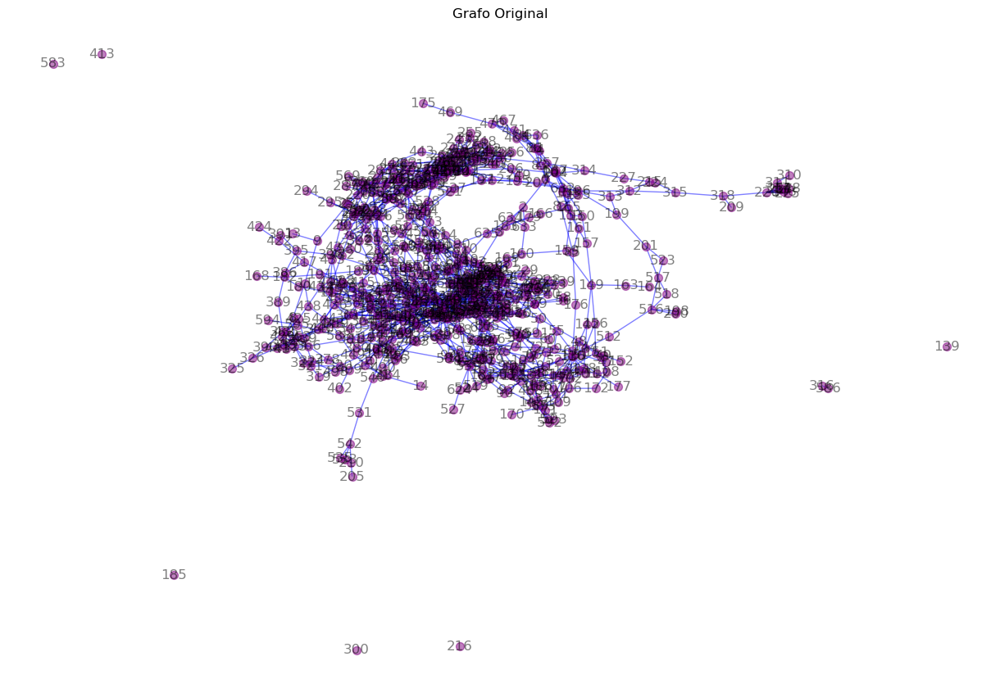

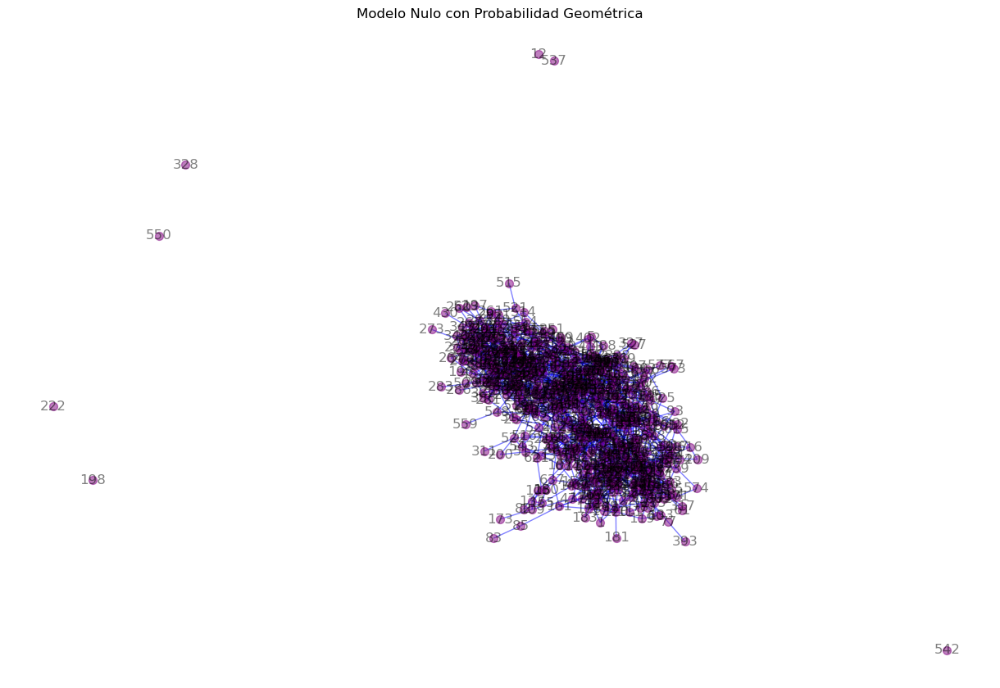

In [31]:
# 10) Generar un modelo nulo utilizando una probabilidad de conexión en función de la distancia geométrica, con el mismo número de nodos y 
# conexiones y compara sus propiedades y discutir la importancia de las conexiones a larga distancia en el cerebro

def propiedades_grafo(G):
    propiedades = {}

    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes() # Grado Promedio
    propiedades['grado_medio'] = avg_grad

    coef_cluster = nx.average_clustering(G) # Coeficiente Cluster
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster

    cercania = np.mean(list(nx.closeness_centrality(G).values())) # Cercanía
    propiedades['centralidad_cercania'] = cercania

    betweenness = nx.betweenness_centrality(G) # Intermediación
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion

    return propiedades


def comparacion_propiedades(datos_originales, datos_modificados):
    print("\nComparación de Propiedades:")
    for prop in datos_originales.keys():
        original = datos_originales[prop]
        modificado = datos_modificados[prop]
        cambio = ((modificado - original) / original) * 100 if original != 0 else "N/A"
        print(f"{prop.capitalize()}:")
        print(f"  Original: {original:.4f}")
        print(f"  Modificado: {modificado:.4f}")
        print(f"  Cambio: {cambio if cambio == 'N/A' else cambio:.2f}%\n")


# Grafo Original
grafo_original = create_graph(matrix, 0.1, coordinates)
datos_originales = propiedades_grafo(grafo_original) # Propiedades del Grafo Original
print(datos_originales)

# Coordenadas de los Nodos
nodos = list(grafo_original.nodes())
pos = nx.get_node_attributes(grafo_original, 'pos')

# Crear Matriz de Distancias entre Nodos
distancias = np.zeros((len(nodos), len(nodos)))
for i in range(len(nodos)):
    for j in range(len(nodos)):
        if i != j:
            distancias[i, j] = np.linalg.norm(np.array(pos[i]) - np.array(pos[j]))

alpha = 0.1 # Parámetro de Decaimiento para la Probabilidad de Conexión
probabilidades = np.exp(-alpha * distancias) # Matriz de Probabilidades basada en la Distancia


# MODELO NULO en Probabilidades de Conexión
num_aristas = grafo_original.number_of_edges()
modelo_nulo = nx.Graph()
modelo_nulo.add_nodes_from(nodos)

# Establecer Conexiones Aleatorias basadas en las Probabilidades
aristas = []
while len(aristas) < num_aristas:
    i, j = np.random.choice(len(nodos), size=2, replace=False)
    if (i, j) not in aristas and (j, i) not in aristas:
        if np.random.rand() < probabilidades[i, j]:
            aristas.append((i, j))

modelo_nulo.add_edges_from(aristas)

datos_nulo = propiedades_grafo(modelo_nulo) # Propiedades del Modelo Nulo
print(datos_nulo)


# Compararación
comparacion_propiedades(datos_originales, datos_nulo)

# Visualización
def plot_grafo(G, titulo):
    pos = nx.spring_layout(G)  # Layout para visualizar en 2D
    plt.figure(figsize=(12, 8))
    nx.draw(G, pos, with_labels=True, node_color='purple', node_size=50, edge_color='blue', alpha=0.5)
    plt.title(titulo)
    plt.show()

# Graficar
plot_grafo(grafo_original, "Grafo Original")
plot_grafo(modelo_nulo, "Modelo Nulo con Probabilidad Geométrica")

In [ ]:
# Discusión 
# Los componentes que mostraron una disminución fueron: Cluster (0.2436-> 0.0523, el modelo geométrico se limita a las conexiones locales. El SN tiene 
# conexiones a larga distancia que son cruciales para la formación de clusters ya que, unen regiones que comparten funciones, contribuyendo así a la 
# modularidad), Intermediación (0.0115-> 0.0065, disminuye la probabilidad de tener hubs). Por otro lado, la Cercanía incrementa (0.1194-> 0.1890, las 
# distancias son cortas porque casi todo es a nivel local, mejora la eficiencia pero al igual que en el modelo anterior se sacrifica la especialización). 
# El Grado Promedio se mantuvo igual (por las conexiones aleatorias). El SN distribuye conexiones a larga distancia para equilibrar la comunicación 
# eficiente con la especialización (para realizar tareas más complejas).

In [ ]:
# 11) Escribir una reseña de lo aprendido en el curso, incluyendo la importancia de conocer herramientas de teoría de grafos para comprender 
# la conectividad del cerebro (mínimo 200 palabras)

# A mi consideración, tener conocimiento sobre la Teoría de Grafos, así como las herramientas computacionales para la análsis de redes es indispensable
# para analizar y comprender el funcionamiento y naturaleza del SN. El sistema se organiza en módulos que realizan funciones particulares (áreas o redes
# especializadas para el procesamiento de información sensorio-motora, cognitiva y emocional principalmente) con una compleja organización diseñada para
# mantener la integración tanto local como global, reflejada en su alta modularidad, clustering y en la presencia de Hubs. Me ayudó a comprender mejor
# características importantes como la robustez inherente del sistema para el mantenimiento de funciones (persistencia incluso después de lesiones, además
# una misma función puede ser realizada por varios elementos contribuyendo a la redundancia), así como la resiliencia donde la distribución de conexiones
# especialmente las de larga distancia refuerza la red. Todas estas características son cruciales hablando en términos de neuroplasticidad, donde las redes
# son circuitos flexibles que se pueden reconfigurar constantemente en respuesta a una gran variedad de estímulos ambientales internos o externos al 
# organismo, así como la experiencia; pero al mismo tiempo se garantiza cierta estabilidad para mantener la homeostasis. Me pareció interesante cómo el SN
# sacrifica un poco de eficiencia para ganar especialización, evolutivamente esta adaptación es acertada para el procesamiento de información y ganar
# capacidades cognitivas superiores. Creo que son conceptos fundamentales para aplicarlo hacia los cambios en trastornos psiquiátricos y enfermedades
# neurodegenerativas, aunado a la protección frente a lesiones neurológicas.